In [3]:
from vega import VegaLite
from IPython.display import display
import json
import csv


In [ ]:
def generate_scatterplot(data, color='name', info='media_id', info2='story_id', media_wanted=0, x_field='x', y_field='y', title='PCA'):
    
    scatterplot= {
      
        
    if media_wanted!=0:
        transform={
            "transform":[
                        {
                        "filter":
                            {
                            "field":"media_id",
                            "equal":media_wanted
                            }
                        }
                    ]
            }
        scatterplot.update(transform)
            
    return scatterplot

In [1]:
def generate_line(data, features):
    
    lines={
        "width":600,
        "height":600,
        "data": {
            "values":data
                },
        "encoding": {
        "x": {"field": "x", "type": "quantitative"},
        "y": {"field": "y", "type": "quantitative"},
        },
        "layer":[]
    }
    
    
    for feature in features:
        layer={   
        "transform":[
            {
            "filter":
                    {
                    "field":"feature",
                    "equal":feature
                    }
            }
          ],
        "layer":[
            {
            "mark":
                {
                "type":"line",
                },
            "encoding":
                {
                "color":
                    {
                "field": "feature",
                "type": "nominal"
                    }
                } 
            },
            {
            "transform":[
                {
                "filter":
                    {
                    "field":"middle",
                    "equal":"yes"
                    }
                }
              ],
             "mark":     
                {
                "type": "text",
                "text":feature
                },
                "encoding":
                {
                    "tooltip":[

                        {"field": "feature", "type": "nominal"},
                        {"field": "x", "type": "quantitative"},
                        {"field": "y", "type": "quantitative"}

                    ]
                }
            }
            
        ]
        }
    
    

        lines["layer"].append(layer)
    
    return lines

In [4]:
def generate_several_scatterplots(data, list_filter, field_filter, color='name', info='media_id', info2='story_id', x_field='x', y_field='y'):
    
    scatterplot= {
        "data": data,
        'vconcat':[]
        }
    for item in list_filter:
        new={
             "selection": 
                    {
                     "org":
                        {
                        "empty":"none",   
                        "type":"single",
                        "fields":[color]
                        }
                        ,
                    "org2":
                        {
                        "empty":"all",
                        "type":"single",
                        "fields":[color]
                        }
                    },
            
            "width": 400,
            "height": 400,
            "title": item,
            "transform":[
                        {
                        "filter":
                            {
                            "field":field_filter,
                            "equal":item
                            }
                        }
                    ],
            "mark": "circle",
            "encoding":
                {
                "x":
                    {
                    "field": "x",
                    "type": "quantitative"
                    },
                "y":
                    {
                    "field": "y",
                    "type": "quantitative"
                    },
            "color":
                {
                "condition":{
                    "selection":"org2",
                    "type":"nominal",
                    "field":color
                },
                "value":"tranparent"
                },                    
                
            "tooltip":
                [
                {"field": color, "type": "nominal"},
                {"field": info, "type": "quantitative"},
                {"field": info2, "type": "quantitative"}
                ],
            "size": {
                "condition":{
                            "selection": "org",
                            "value": 50
                            },
                "value": 10
            }
            #    "size":
            #        {
            #        "aggregate": "count",
            #        "type": "quantitative"
            #        }
                }
        }
        scatterplot["vconcat"].append(new)
            
    return scatterplot

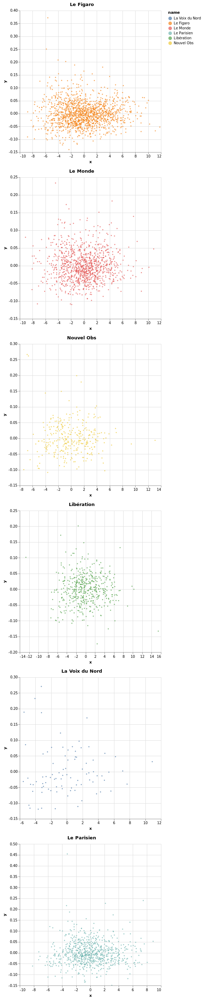

In [5]:
list_medias=["Le Figaro", "Le Monde", "Nouvel Obs", "Libération", "La Voix du Nord", "Le Parisien"]
with open('reg_dim_per_media_data.json', 'r') as f:
    values=json.load(f)

scatterplots=generate_several_scatterplots(values, list_medias, "name")
VegaLite(scatterplots)